In [1]:
import xarray
import numpy as np
import matplotlib.pyplot as plt
import warnings
import glob

from matplotlib.animation import FuncAnimation
from IPython.display import HTML

from mpl_toolkits.basemap import Basemap

from datetime import datetime, timedelta

warnings.filterwarnings("ignore")
BASE_DIR = "/rds/general/user/zr523/home/researchProject/satellite/era5"

In [2]:
import sys
sys.path.append('../dataproc/')

from utils import *

In [3]:
era5_nc_files = glob.glob(f'{BASE_DIR}/data/nc/amphan/*.nc')
io_era5 = xarray.open_mfdataset(era5_nc_files, parallel=True)

india_x0, india_y0 = 78.662109, 20.344627 ; hs_length = 20
map_bounds = get_bbox_square(india_x0, india_y0, hs_length)

In [4]:
def get_datetime_str(np_date):
    datetime_str = np64_to_datetime(np_date).strftime("%Y-%m-%d %H:%M")
    return datetime_str

In [5]:
amphan_era5 = get_cropped_era5_ds(io_era5, map_bounds)

lat = amphan_era5.variables["latitude"][:]
lon = amphan_era5.variables["longitude"][:]
fg10_data = amphan_era5.variables["fg10"][:]
time_data = amphan_era5.variables["time"][:]

map_bounds = [np.min(lon).values, 
              np.min(lat).values, 
              np.max(lon).values, 
              np.max(lat).values]

In [6]:
def get_map_img(m, ax, x, y, data, map_bounds, 
                title=None,
                y_labels=[1, 0, 0, 0],
                x_labels=[0, 0, 0, 1]):
    kwargs = {
        "linewidth": 0.5,
        "color": "k",
        "ax": ax
    }
    
    m.drawcoastlines(**kwargs)
    m.drawcountries(**kwargs)
    m.drawstates(**kwargs)
    cf = m.contourf(x, y, data, cmap='jet', ax=ax)
    
    m.drawparallels(range(int(map_bounds[1])-1, int(map_bounds[3]), 7), labels=y_labels, fontsize=10, ax=ax)
    m.drawmeridians(range(int(map_bounds[0])-1, int(map_bounds[2]), 7), labels=x_labels, fontsize=10, ax=ax)

    if title: ax.set_title(title)

    return cf

In [7]:
fig, ax = plt.subplots(figsize=(7, 7))
fig.tight_layout()

lon_grid, lat_grid = np.meshgrid(lon, lat)

m = Basemap(llcrnrlon=map_bounds[0], llcrnrlat=map_bounds[1],
            urcrnrlon=map_bounds[2], urcrnrlat=map_bounds[3],
            projection='cyl', resolution='l', ax=ax)

np_dt = time_data[0].values
title = f"ERA5 10m Wind Gust - 3s Max\nCyclone Amphan\n{get_datetime_str(np_dt)}"
cf = get_map_img(m, ax, lon_grid, 
            lat_grid, fg10_data[0], 
            map_bounds, title)

cbar = plt.colorbar(cf, ax=ax)
ax_pos = ax.get_position()
cbar.ax.set_position([ax_pos.x0 + ax_pos.width + 0.02, ax_pos.y0, 0.1, ax_pos.height])

def update(frame_idx):
    ax.clear()
    np_dt = time_data[frame_idx].values
    title = f"ERA5 10m Wind Gust - 3s Max\nCyclone Amphan\n{get_datetime_str(np_dt)}"
    get_map_img(m, ax, lon_grid, 
                lat_grid, fg10_data[frame_idx], 
                map_bounds, title)

animation = FuncAnimation(fig, update, frames=fg10_data.shape[0], interval=250)
animation.save('./gifs/era5_fg10_amphan_may20.gif', writer='imagemagick')

plt.close()  
HTML(animation.to_jshtml())

In [8]:
GFS_VARIABLES = [
    ("u10", "10m_u_component_of_wind", "10m Wind U Component"),
    ("v10", "10m_v_component_of_wind", "10m Wind V Component"),
    ("tp", "total_precipitation", "Total Precipitation"),
    ("tcc", "total_cloud_cover", "Total Cloud Cover"),
]

In [9]:
def convert_date_format(date_str):
    date_time = datetime.strptime(date_str, "%d-%m-%Y %H:%M")
    month = date_time.strftime("%b").upper()
    new_date_str = date_time.strftime("%d{month}%Y_%H%M").format(month=month)
    return new_date_str

def get_hrs_from_start(start_date_str, target_date_str):
    start_date  = datetime.strptime(start_date_str, "%d-%m-%Y %H:%M")
    target_date = datetime.strptime(target_date_str, "%d-%m-%Y %H:%M")
    hours_difference = int((target_date - start_date).total_seconds()/3600)
    return hours_difference

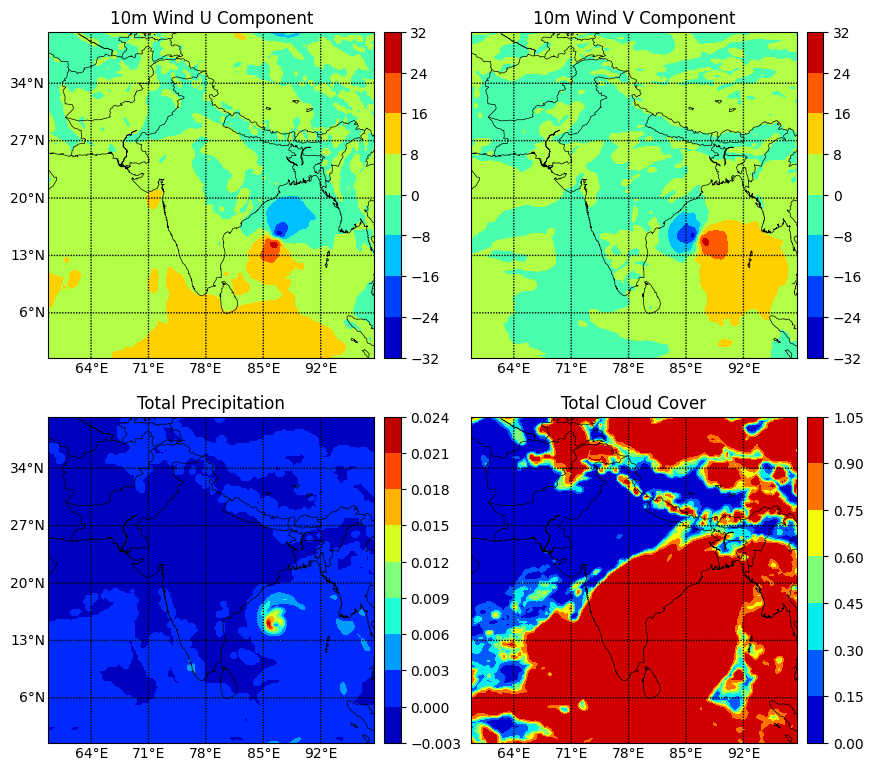

In [10]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

START_DATE_STR  = "16-05-2020 00:00"
TARGET_DATE_STR = "18-05-2020 19:00"

variable = GFS_VARIABLES[0][0]
frame_idx = get_hrs_from_start(START_DATE_STR, TARGET_DATE_STR)

fig, axs = plt.subplots(figsize=(10, 10), nrows=2, ncols=2)

for idx, variable in enumerate(GFS_VARIABLES):
    ax = axs[idx//2][idx%2]

    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.1)

    x, y = lon_grid, lat_grid
    data = amphan_era5.variables[variable[0]][:][frame_idx]
    
    if idx == 0 : y_labels=[1, 0, 0, 0] ; x_labels=[0, 0, 0, 1]
    if idx == 1 : y_labels=[0, 0, 0, 0] ; x_labels=[0, 0, 0, 1]
    if idx == 2 : y_labels=[1, 0, 0, 0] ; x_labels=[0, 0, 0, 1]
    if idx == 3 : y_labels=[0, 0, 0, 0] ; x_labels=[0, 0, 0, 1]

    cf = get_map_img(m, ax, lon_grid, 
                     lat_grid, 
                     data, map_bounds, y_labels=y_labels, x_labels=x_labels)

    ax.set_title(f"{variable[2]}")
    fig.colorbar(cf, cax=cax, orientation='vertical')
    
plt.subplots_adjust(hspace=0)    
plt.savefig(f'./pngs/era5_amphan_{convert_date_format(TARGET_DATE_STR)}.png', bbox_inches='tight', pad_inches=0)